# BÀI TẬP VỀ NHÀ

1. Thực hành phát hiện góc trên các ảnh trong thư mục corner.
2. Chụp một số ảnh thực tế. Áp dụng phương pháp Harris corner với cùng bộ tham số trên ảnh với các tỉ lệ scale khác nhau (ví dụ phóng to 2 lần, thu nhỏ 2 lần). So sánh kết quả.
3. Áp dụng các hàm describe và match keypoint đối với các ảnh 'yosemite*.jpg'

In [1]:
from IPython.display import Image
from skimage.feature import corner_peaks

import matplotlib.pyplot as plt
import os
import cv2
import numpy as np

### Hàm show image

In [2]:
def showImage(img,cmap='color'):
    fig, ax = plt.subplots(1, 1, figsize=(15, 12))
    if cmap=='color':
        plt.imshow(img)
    elif cmap=='gray':
        plt.imshow(img,cmap='gray')
    else:
        raise
    plt.axis('off')
    plt.show()

### Hàm phát hiện góc Harris corner

In [3]:
def detectCorner(img,gray,blockSize=2,kSize=3,k=0.04,rel_threshold=0.01):
    response = cv2.cornerHarris(gray,blockSize,kSize,k)
    corners = corner_peaks(response, threshold_rel=rel_threshold)
    print(corners.shape)

    # Display detected corners
    fig, ax = plt.subplots(1, 1, figsize=(15, 12))
    plt.imshow(img)
    plt.scatter(corners[:,1], corners[:,0], marker='x',c='red')
    plt.axis('off')
    plt.title('Detected Corners')
    plt.show()


### Các hàm Describing and Matching Keypoints

Ở hàm **`simple_descriptor`**, mỗi keypoint được mô tả bằng cách normalize mức xám trong một vùng xác định quanh keypoint đó.

In [4]:
def simple_descriptor(patch):
    """
    Describe the patch by normalizing the image values into a standard 
    normal distribution (having mean of 0 and standard deviation of 1) 
    and then flattening into a 1D array. 
    
    The normalization will make the descriptor more robust to change 
    in lighting condition.
    
    Hint:
        If a denominator is zero, divide by 1 instead.
    
    Args:
        patch: grayscale image patch of shape (h, w)
    
    Returns:
        feature: 1D array of shape (h * w)
    """
    feature = []
    ### YOUR CODE HERE
    std = np.std(patch)
    mean = np.mean(patch)
    if std > 0.0:
        feature = (patch - mean) / std
    else:
        feature = patch - mean
    feature = feature.reshape(-1)
    ### END YOUR CODE
    return feature

In [5]:
def describe_keypoints(image, keypoints, desc_func, patch_size=16):
    """
    Args:
        image: grayscale image of shape (H, W)
        keypoints: 2D array containing a keypoint (y, x) in each row
        desc_func: function that takes in an image patch and outputs
            a 1D feature vector describing the patch
        patch_size: size of a square patch at each keypoint
                
    Returns:
        desc: array of features describing the keypoints
    """

    image.astype(np.float32)
    desc = []

    for i, kp in enumerate(keypoints):
        y, x = kp
        patch = image[y-(patch_size//2):y+((patch_size+1)//2),
                      x-(patch_size//2):x+((patch_size+1)//2)]
        desc.append(desc_func(patch))
    return np.array(desc)

Hàm **`match_descriptors`** giúp xác định các cặp điểm "match" giữa hai tập desciptors. Đầu tiên, tính khoảng cách Euclid giữa mọi cặp desciptor của ảnh 1 và ảnh 2. Sau đó, tìm kiếm các cặp "match" bằng cách xác định: nếu khoảng cách tới điểm gần nhất nhỏ hơn đáng kể so với khoảng cách tới điểm gần thứ hai, ta coi cặp điểm với khoảng cách gần nhất đó là "match".

In [6]:
from scipy.spatial.distance import cdist

def match_descriptors(desc1, desc2, threshold=0.5):
    """
    Match the feature descriptors by finding distances between them. A match is formed 
    when the distance to the closest vector is much smaller than the distance to the 
    second-closest, that is, the ratio of the distances should be smaller
    than the threshold. Return the matches as pairs of vector indices.
    
    Args:
        desc1: an array of shape (M, P) holding descriptors of size P about M keypoints
        desc2: an array of shape (N, P) holding descriptors of size P about N keypoints
        
    Returns:
        matches: an array of shape (Q, 2) where each row holds the indices of one pair 
        of matching descriptors
    """
    matches = []
    
    N = desc1.shape[0]
    dists = cdist(desc1, desc2)

    ### YOUR CODE HERE
    for i in range(N):
        dist = dists[i, :]
        if np.min(dist) / (np.partition(dist, 2)[1]) <= threshold:
            matches.append([i, np.argmin(dist)])
    matches = np.array(matches).reshape(-1, 2)
    ### END YOUR CODE
    
    return matches

## Bài tập về nhà
### Phần 1. Corners detection

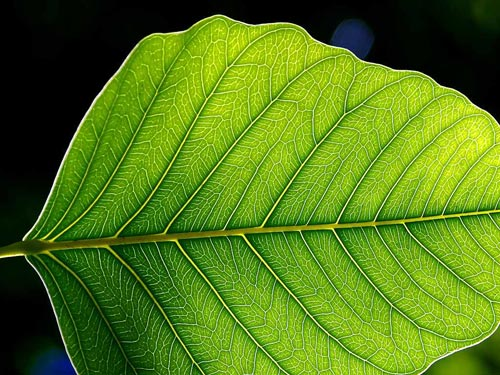

In [7]:
Image('corner/leaf.jpg')

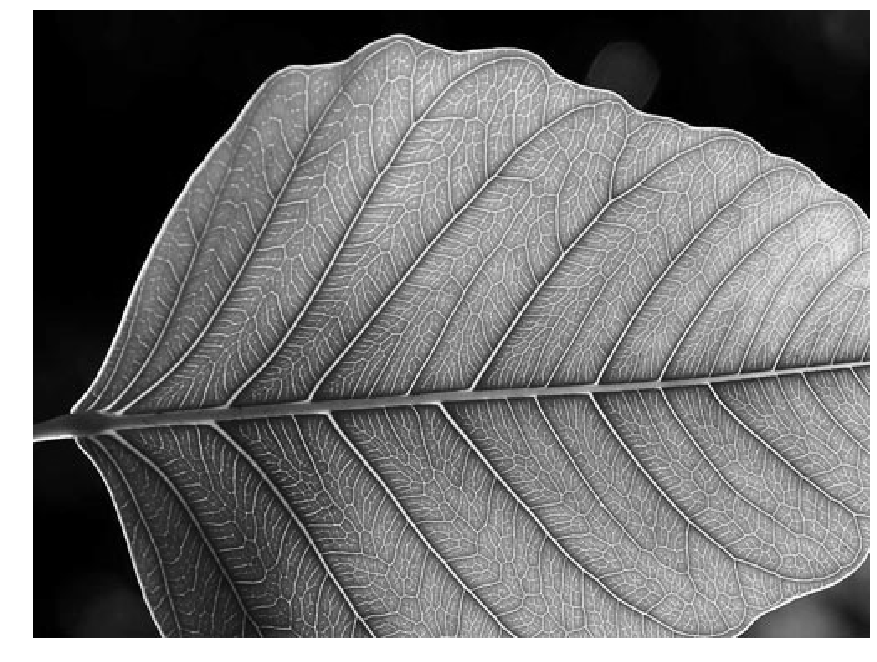

In [8]:
img=cv2.imread('corner/leaf.jpg')
img=cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
gray=cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
# gray=cv2.medianBlur(gray,3)
# gray=cv2.GaussianBlur(gray,(5,5),0)
showImage(gray,cmap='gray')

(699, 2)


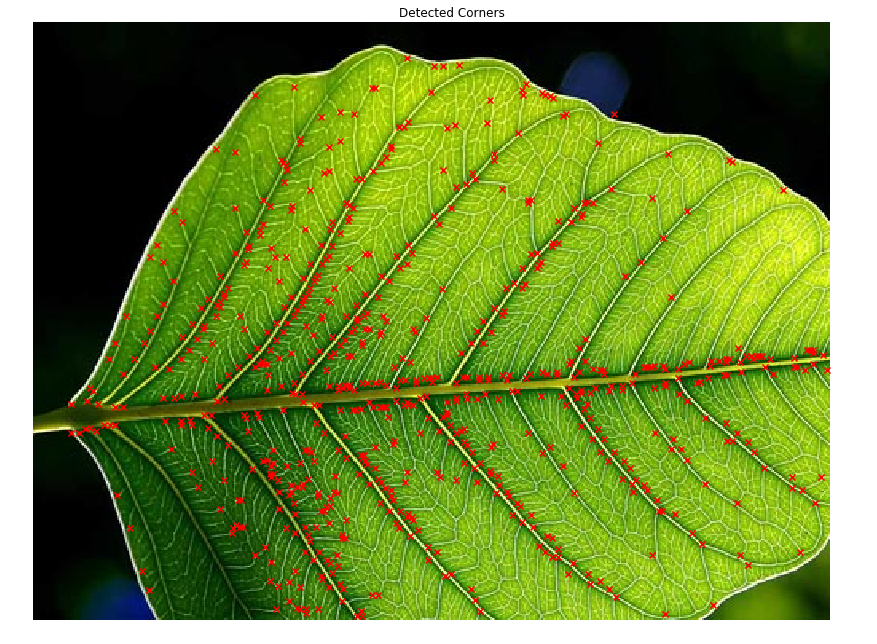

In [9]:
detectCorner(img,gray,blockSize=5,kSize=5,k=0.04,rel_threshold=0.005)

(3608, 2)


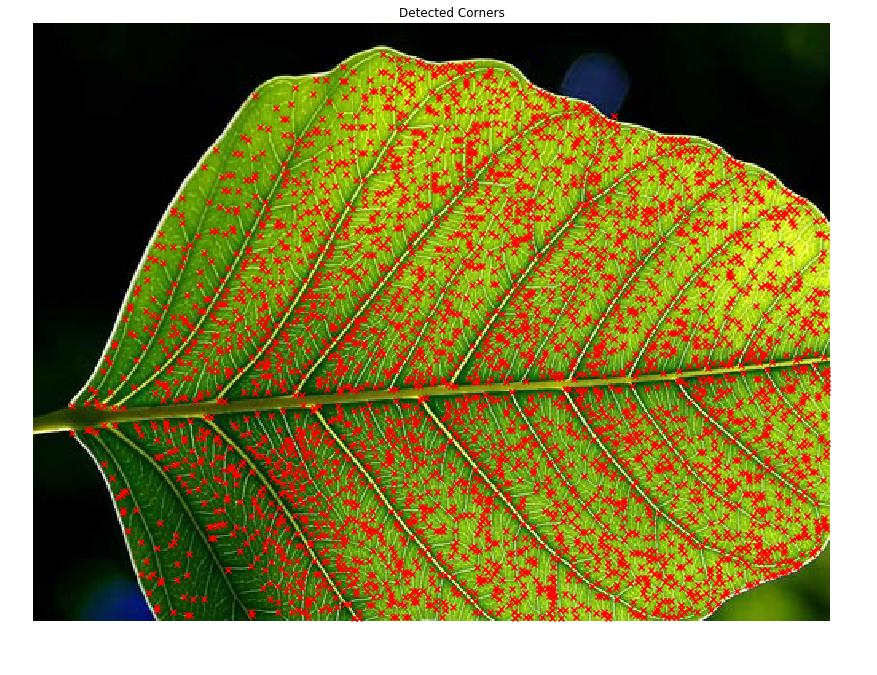

In [10]:
detectCorner(img,gray,blockSize=4,kSize=3,k=0.04,rel_threshold=0.002)

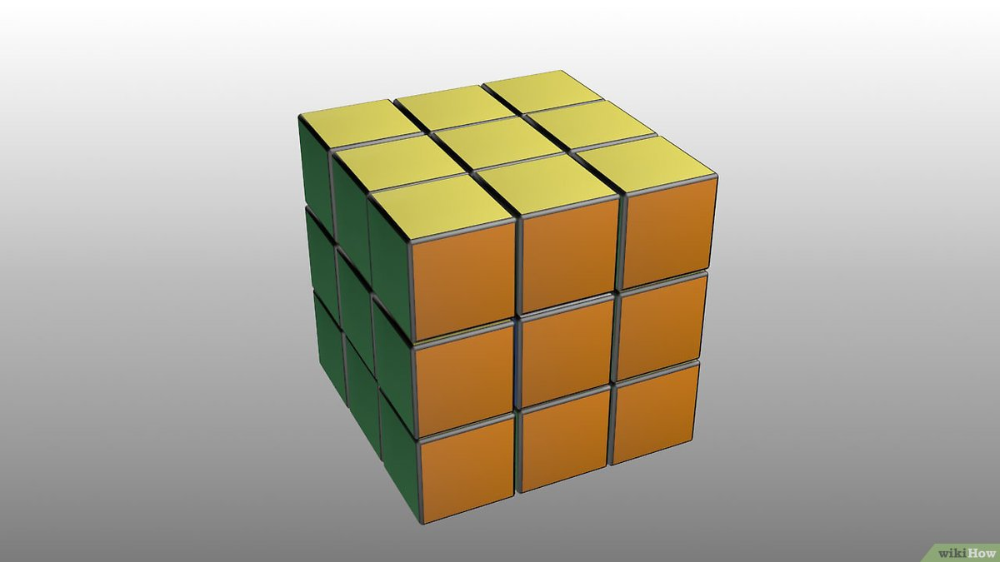

In [11]:
Image('corner/rubik.jpg')

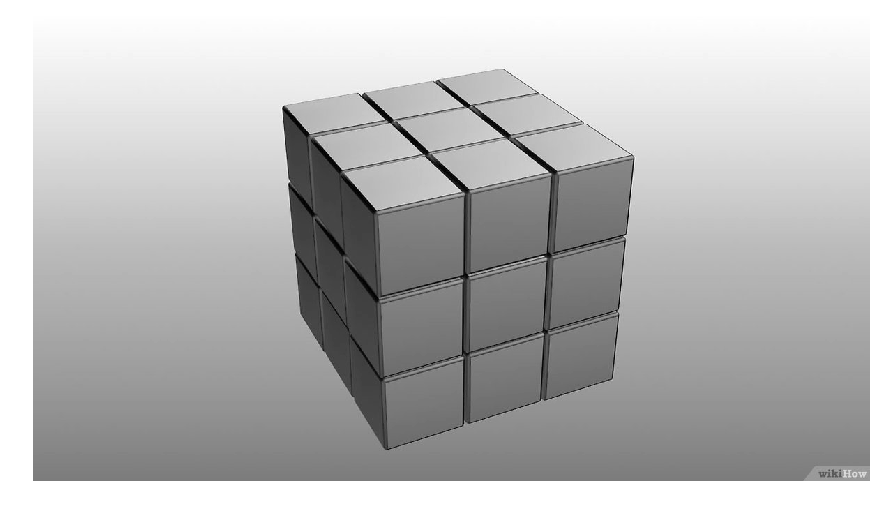

In [12]:
img=cv2.imread('corner/rubik.jpg')
img=cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
gray=cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
showImage(gray,cmap='gray')

(174, 2)


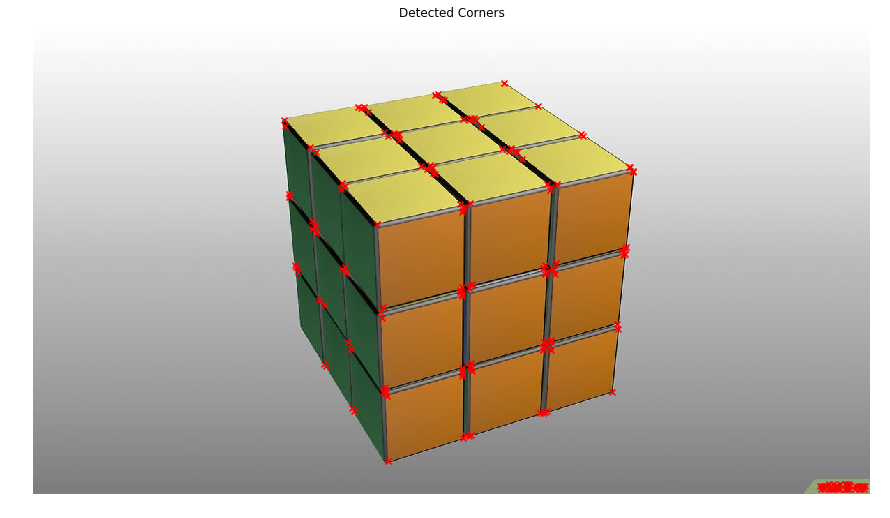

In [13]:
detectCorner(img,gray,blockSize=5,kSize=5,k=0.04,rel_threshold=0.001)

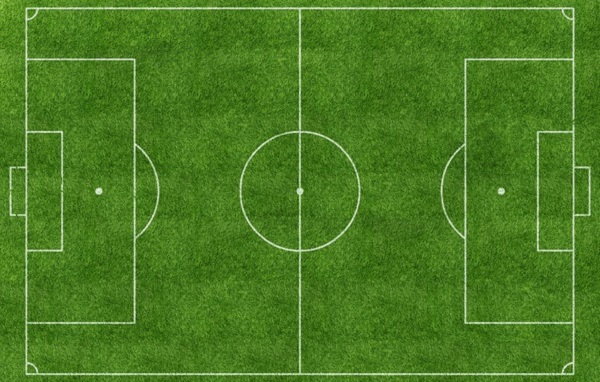

In [14]:
Image('corner/stadium.jpg')

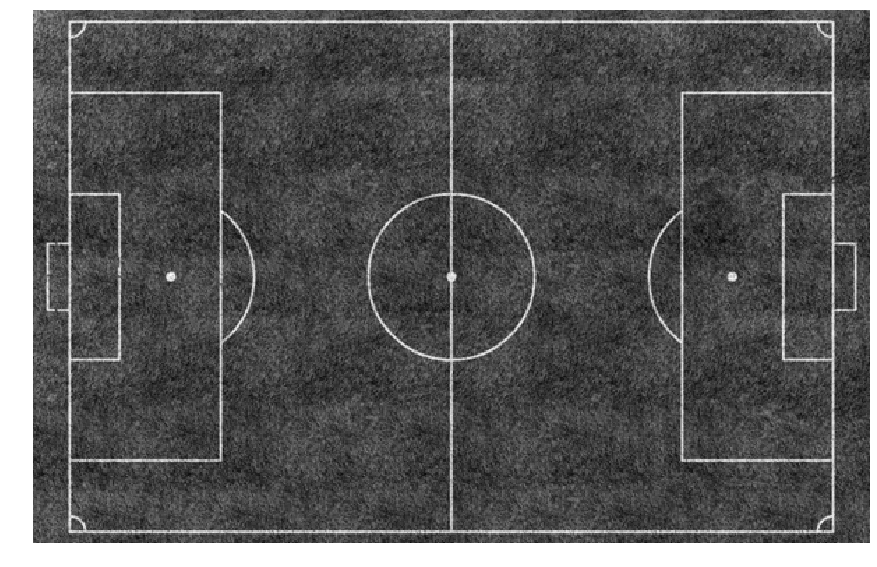

In [15]:
img=cv2.imread('corner/stadium.jpg')
img=cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
gray=cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
showImage(gray,cmap='gray')

(142, 2)


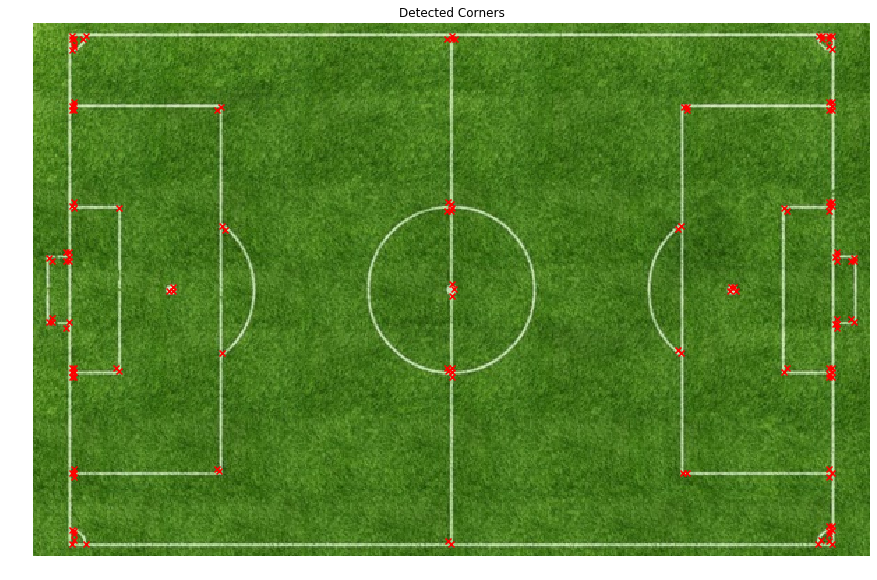

In [16]:
detectCorner(img,gray,blockSize=5,kSize=5,k=0.04,rel_threshold=0.2)

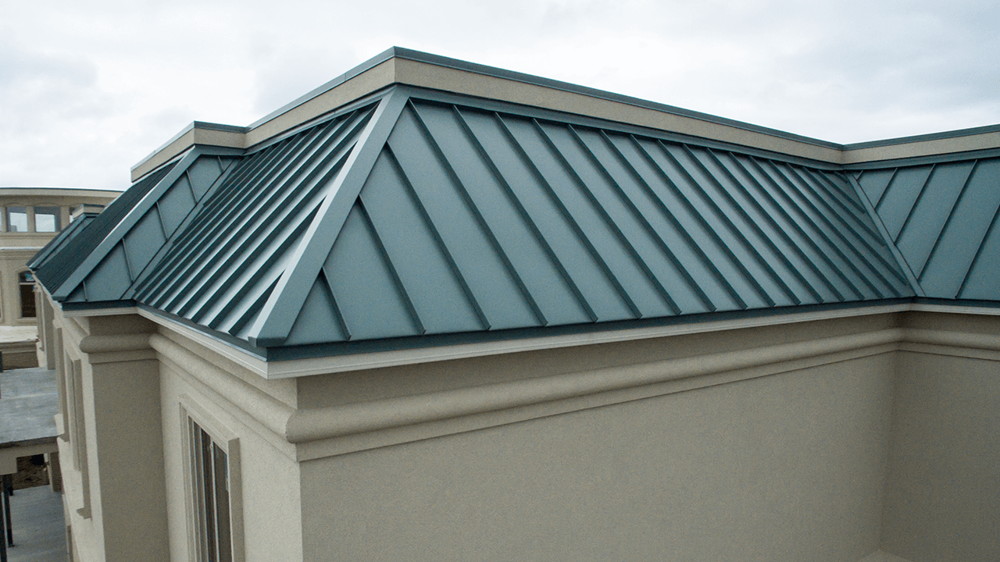

In [17]:
Image('corner/roof.png')

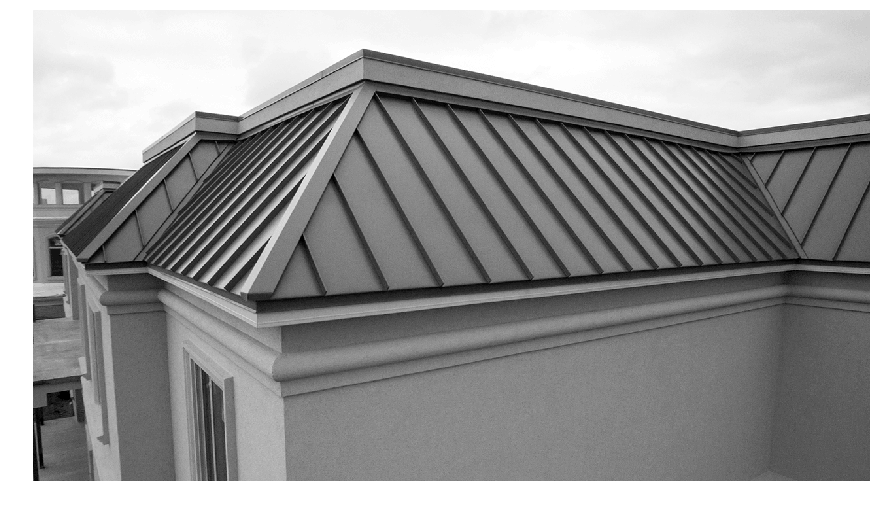

In [18]:
img=cv2.imread('corner/roof.png')
img=cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
gray=cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
showImage(gray,cmap='gray')


(374, 2)


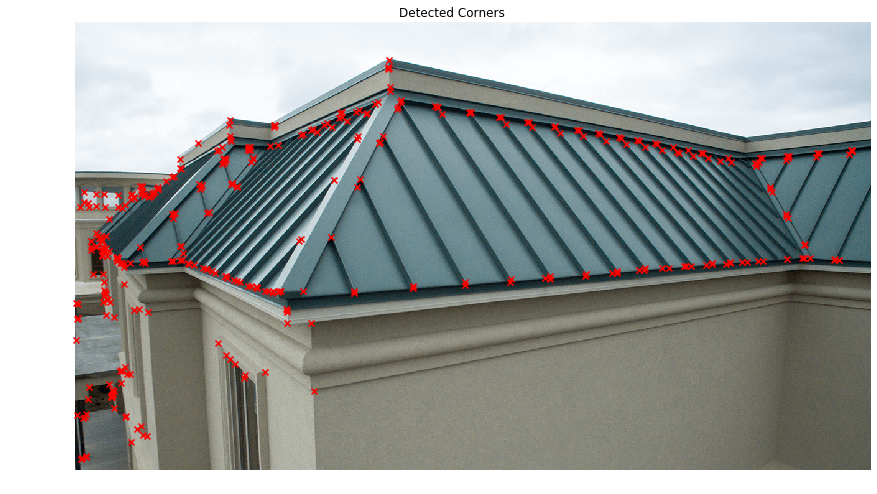

In [19]:
detectCorner(img,gray,blockSize=2,kSize=5,k=0.04,rel_threshold=0.005)

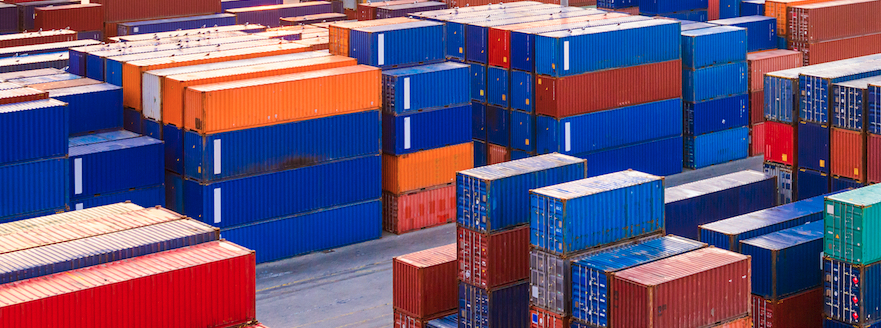

In [20]:
Image('corner/port.png')

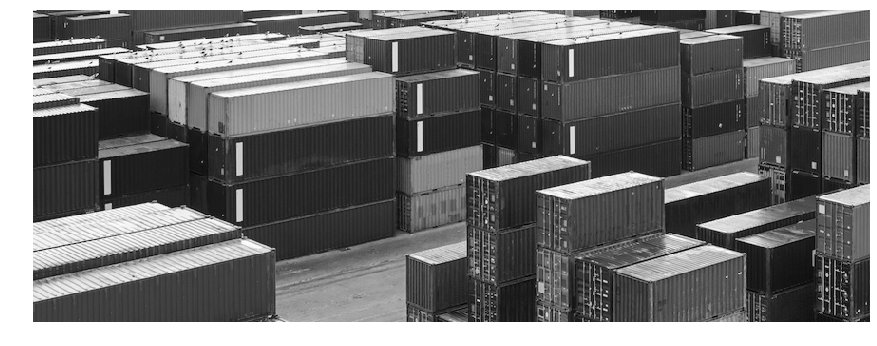

In [21]:
img=cv2.imread('corner/port.png')
img=cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
gray=cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
# gray=cv2.equalizeHist(gray)
# gray=cv2.GaussianBlur(gray,(3,3),0)
showImage(gray,cmap='gray')

(781, 2)


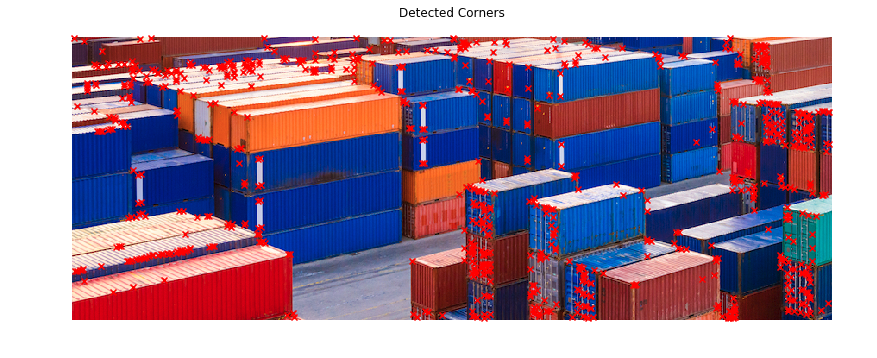

In [22]:
detectCorner(img,gray,blockSize=5,kSize=3,k=0.04,rel_threshold=0.03)

## Phần 2
Chụp một số ảnh thực tế. Áp dụng phương pháp Harris corner với cùng bộ tham số trên ảnh với các tỉ lệ scale khác nhau (ví dụ phóng to 2 lần, thu nhỏ 2 lần). So sánh kết quả.

### 1.Giả lập ảnh scale sử dụng opencv  
Ảnh được scale với tỉ lê 1/2,1/4,1/8.

(3000, 4000, 3)


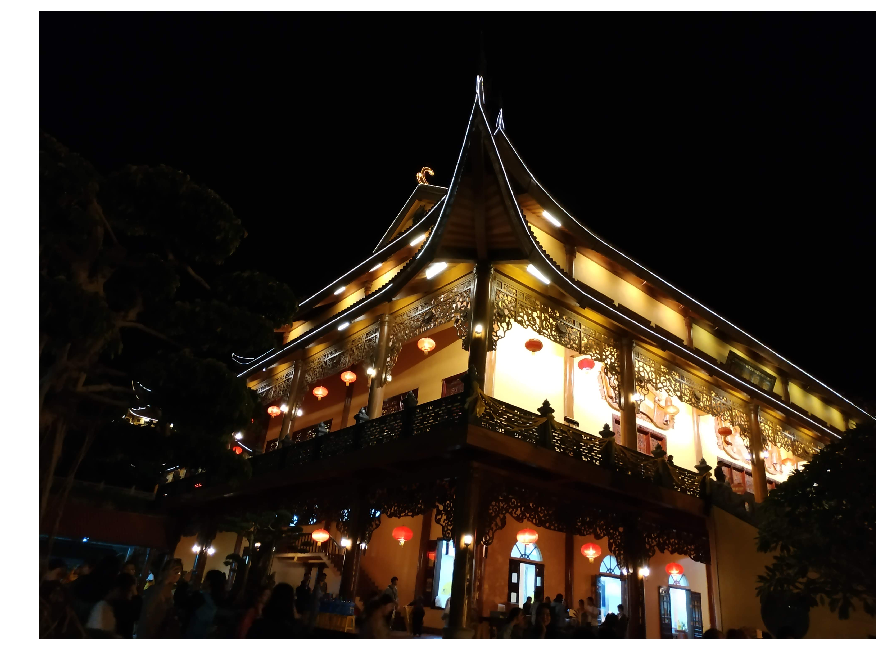

In [23]:
img1=cv2.imread('photo/photo0.jpg')
print(img1.shape)
img1=cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)
gray1=cv2.cvtColor(img1,cv2.COLOR_RGB2GRAY)
showImage(img1)

(1500, 2000, 3)


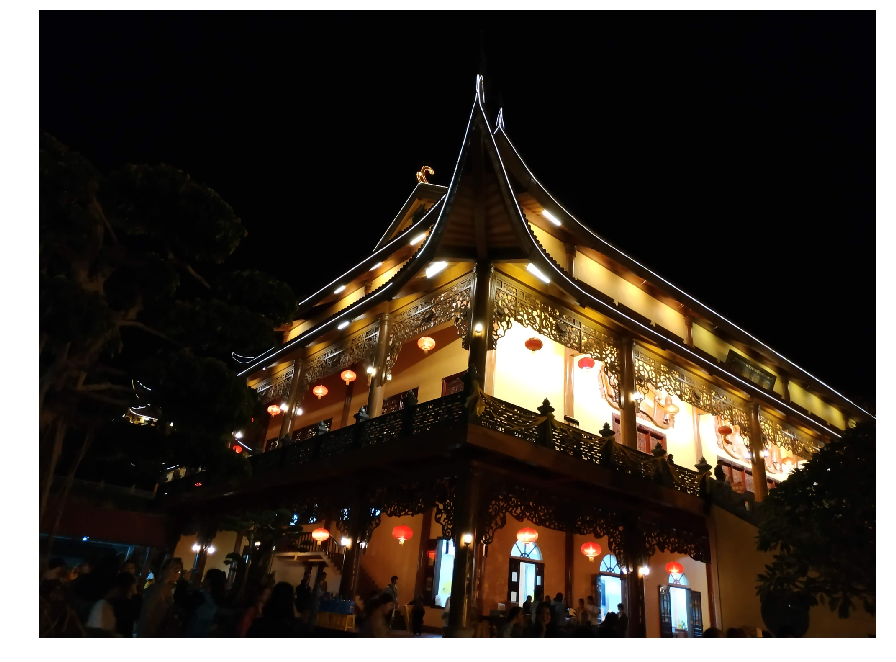

In [24]:
img2=cv2.resize(img1,(img1.shape[1]//2,img1.shape[0]//2))
print(img2.shape)
gray2=cv2.cvtColor(img2,cv2.COLOR_RGB2GRAY)
showImage(img2)


(750, 1000, 3)


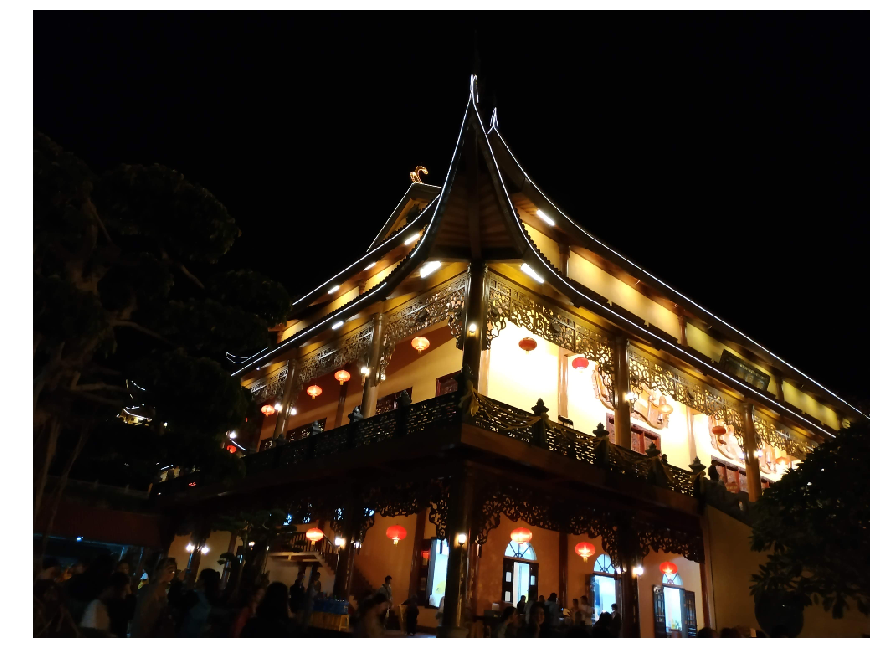

In [25]:
img3=cv2.resize(img1,(img1.shape[1]//4,img1.shape[0]//4))
print(img3.shape)
gray3=cv2.cvtColor(img3,cv2.COLOR_RGB2GRAY)
showImage(img3)


(375, 500, 3)


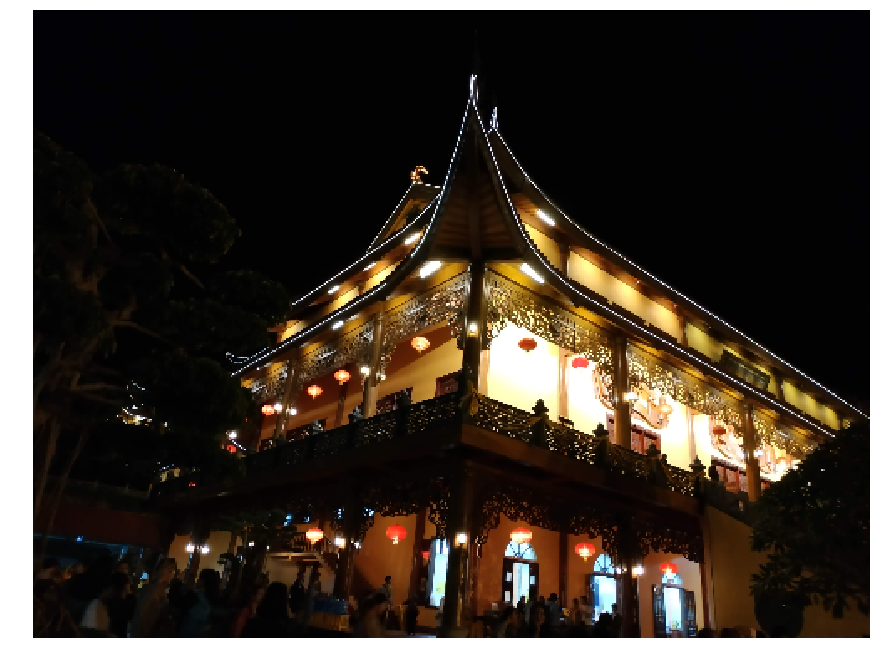

In [26]:
img4=cv2.resize(img1,(img1.shape[1]//8,img1.shape[0]//8))
print(img4.shape)
gray4=cv2.cvtColor(img4,cv2.COLOR_RGB2GRAY)
showImage(img4)


(922, 2)


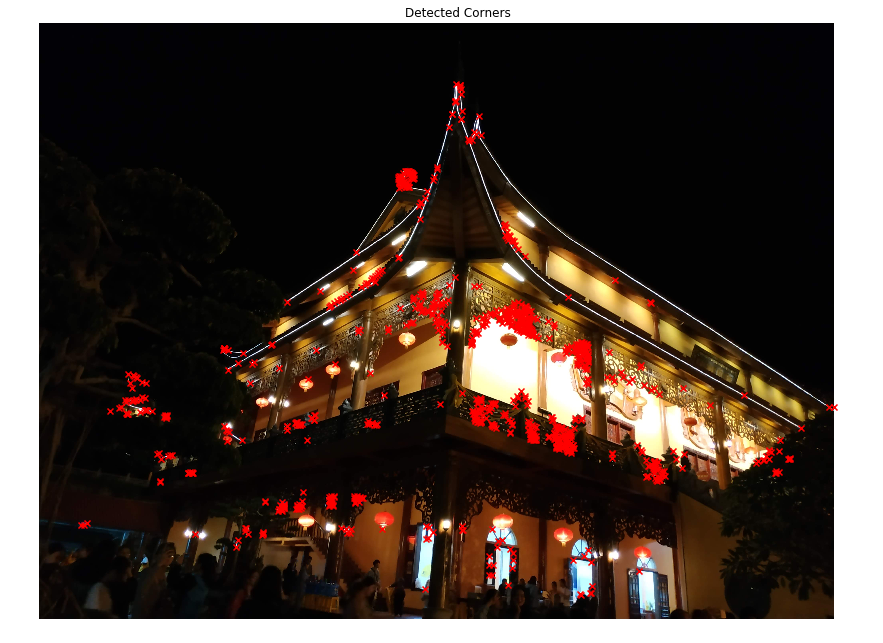

In [27]:
detectCorner(img1,gray1,blockSize=5,kSize=5,k=0.04,rel_threshold=0.1)

(629, 2)


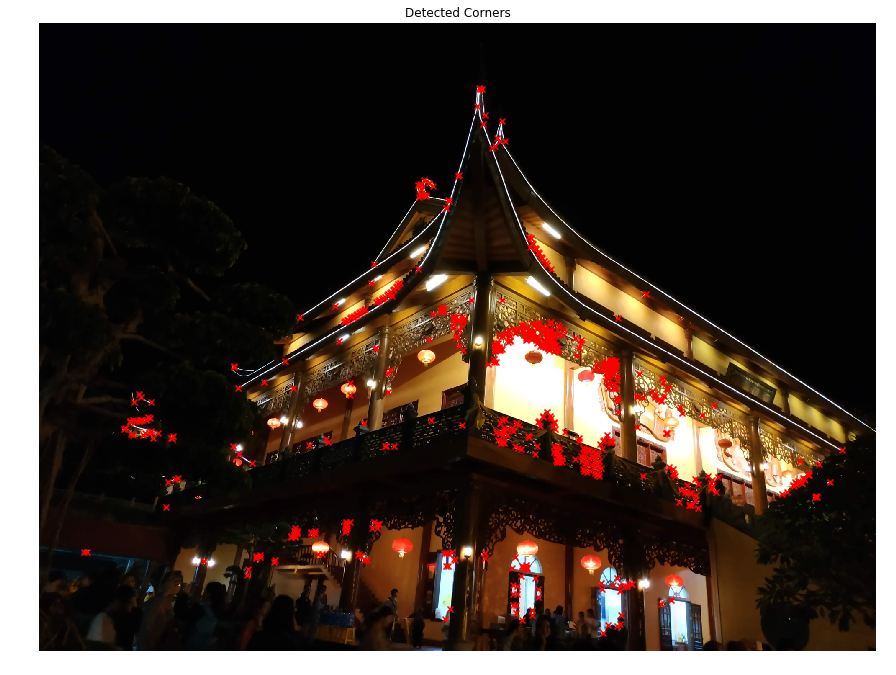

In [28]:
detectCorner(img2,gray2,blockSize=5,kSize=5,k=0.04,rel_threshold=0.1)

(266, 2)


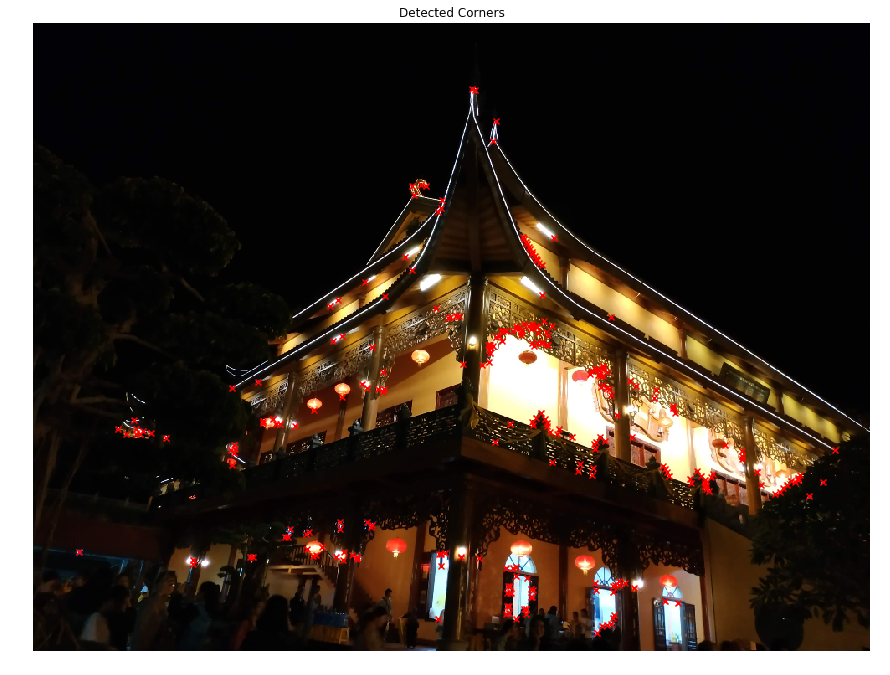

In [29]:
detectCorner(img3,gray3,blockSize=5,kSize=5,k=0.04,rel_threshold=0.1)

(142, 2)


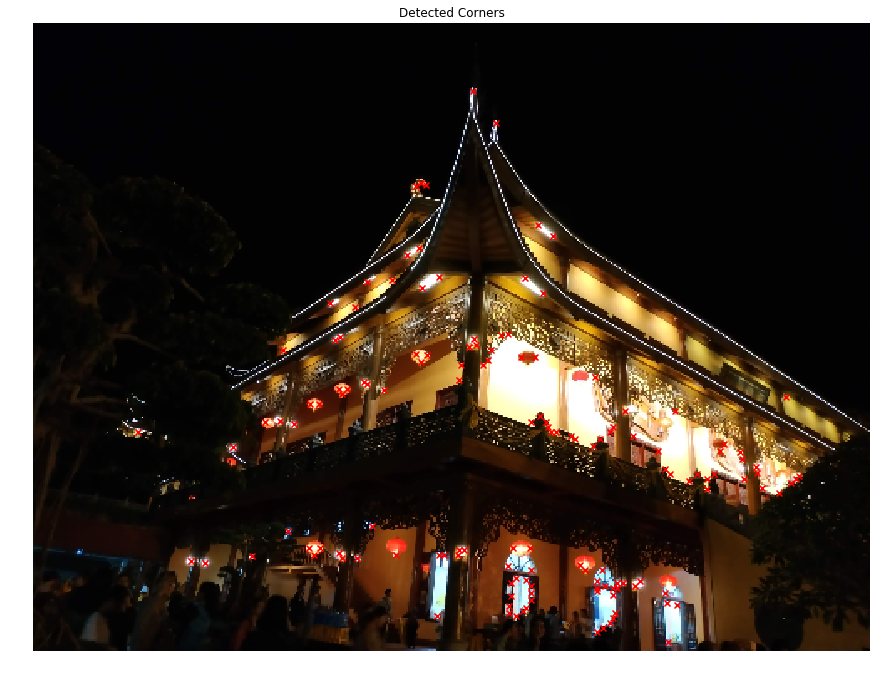

In [30]:
detectCorner(img4,gray4,blockSize=5,kSize=5,k=0.04,rel_threshold=0.1)

### Ảnh thực tế scale với các kích thước khác nhau
Ảnh chụp từ các khoảng cách khác nhau.

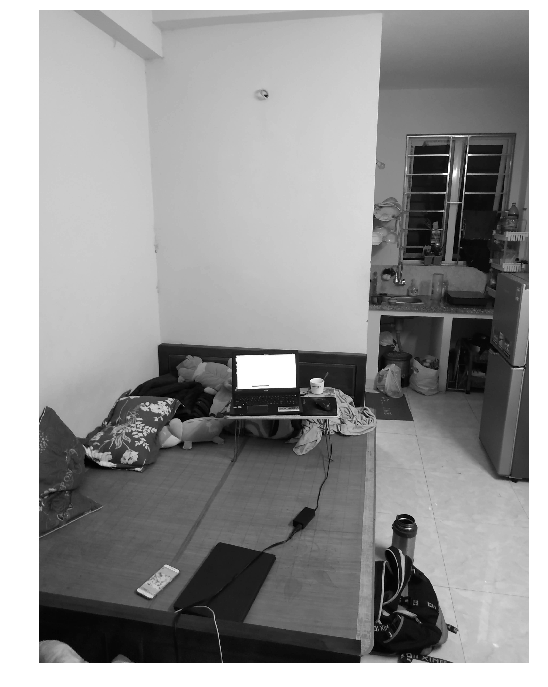

In [31]:
img1=cv2.imread('photo/photo1.jpg')
img1=cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)
gray1=cv2.cvtColor(img1,cv2.COLOR_RGB2GRAY)
showImage(gray1,cmap='gray')

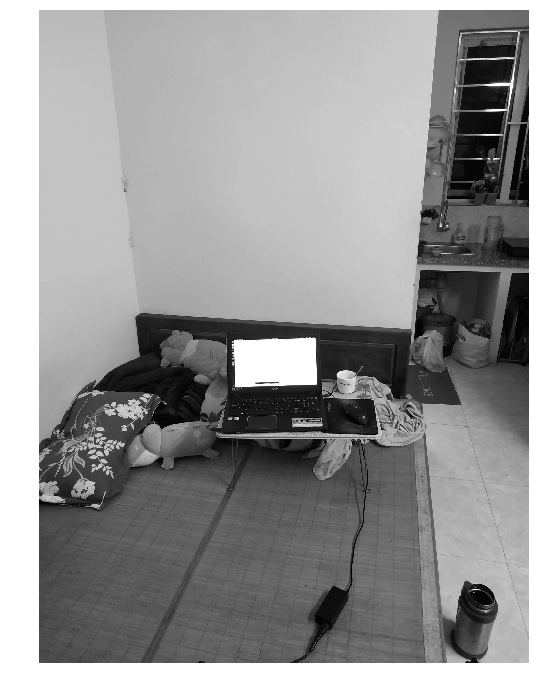

In [32]:
img2=cv2.imread('photo/photo2.jpg')
img2=cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)
gray2=cv2.cvtColor(img2,cv2.COLOR_RGB2GRAY)
showImage(gray2,cmap='gray')

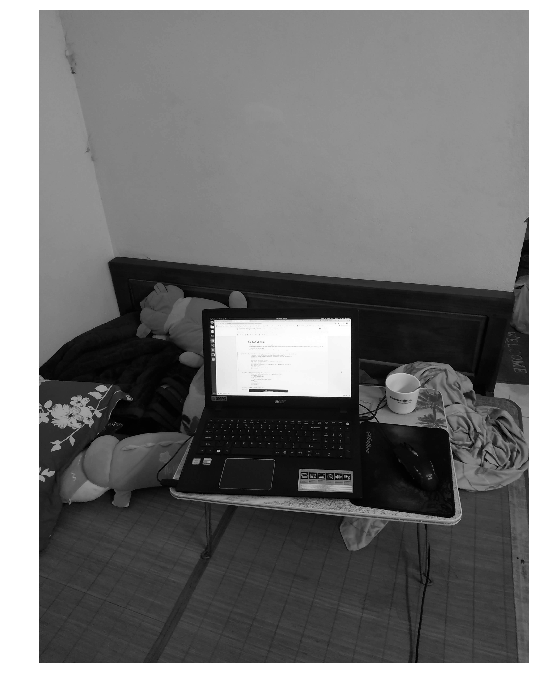

In [33]:
img3=cv2.imread('photo/photo3.jpg')
img3=cv2.cvtColor(img3,cv2.COLOR_BGR2RGB)
gray3=cv2.cvtColor(img3,cv2.COLOR_RGB2GRAY)
showImage(gray3,cmap='gray')

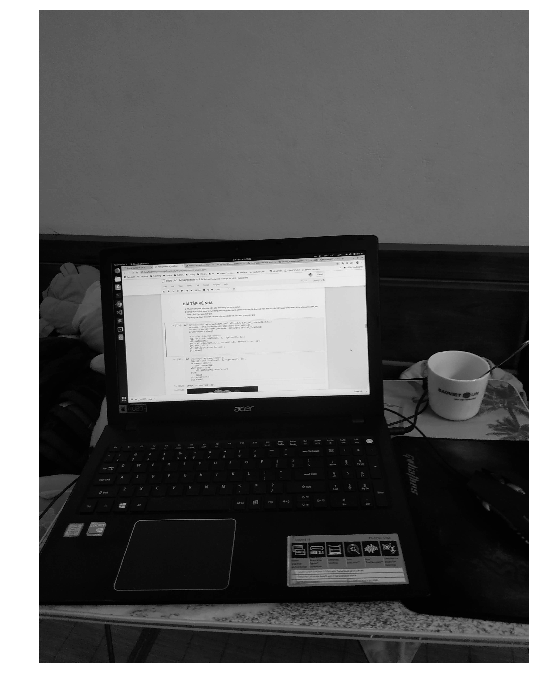

In [34]:
img4=cv2.imread('photo/photo4.jpg')
img4=cv2.cvtColor(img4,cv2.COLOR_BGR2RGB)
gray4=cv2.cvtColor(img4,cv2.COLOR_RGB2GRAY)
showImage(gray4,cmap='gray')

(1011, 2)
(1527, 2)
(1064, 2)
(4470, 2)


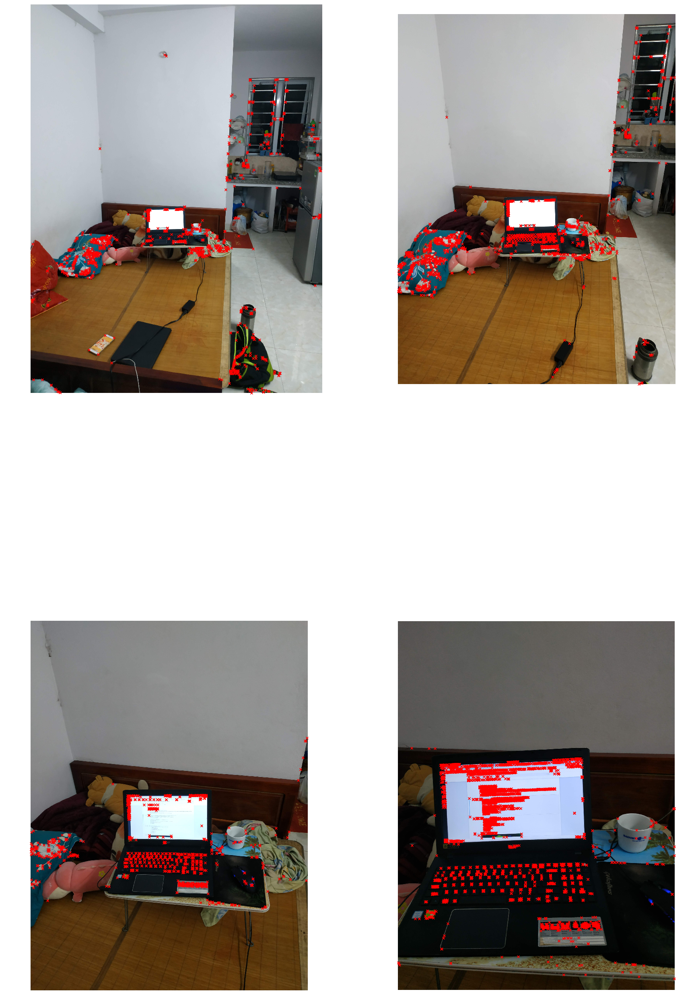

In [35]:
img=[img1,img2,img3,img4]
gray=[gray1,gray2,gray3,gray4]

blockSize=5; ksize=3; k=0.04; rel_threshold=0.01

fig, ax = plt.subplots(2, 2, figsize=(30, 50))
for i in range(4):    
    response = cv2.cornerHarris(gray[i],blockSize,ksize,k)
    corners = corner_peaks(response, threshold_rel=rel_threshold)
    print(corners.shape)

    # Display detected corners
    plt.subplot(2,2,i+1)
    plt.imshow(img[i])
    plt.scatter(corners[:,1], corners[:,0], marker='x',c='red')
    plt.axis('off')
plt.show()

## Phần 2: Keypoint matching

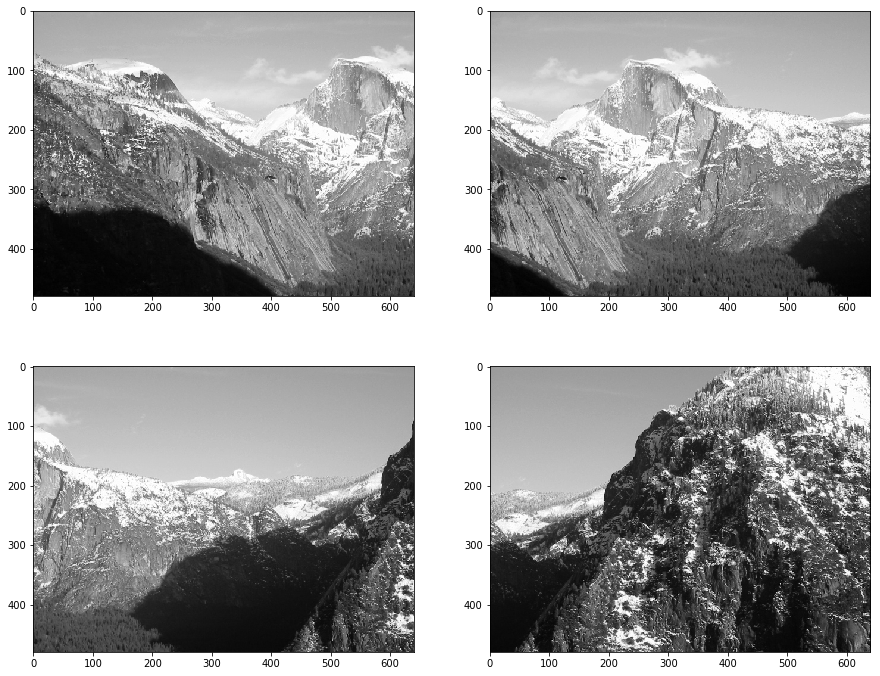

In [36]:
plt.subplots(2, 2, figsize=(15, 12))
plt.subplot(221)
plt.imshow(cv2.imread('yosemite1.jpg', 0), cmap='gray')

plt.subplot(222)
plt.imshow(cv2.imread('yosemite2.jpg', 0), cmap='gray')

plt.subplot(223)
plt.imshow(cv2.imread('yosemite3.jpg', 0), cmap='gray')

plt.subplot(224)
plt.imshow(cv2.imread('yosemite4.jpg', 0), cmap='gray')


In [37]:
img1=cv2.imread('yosemite1.jpg',cv2.IMREAD_GRAYSCALE)
img2=cv2.imread('yosemite2.jpg',cv2.IMREAD_GRAYSCALE)
img3=cv2.imread('yosemite3.jpg',cv2.IMREAD_GRAYSCALE)
img4=cv2.imread('yosemite4.jpg',cv2.IMREAD_GRAYSCALE)

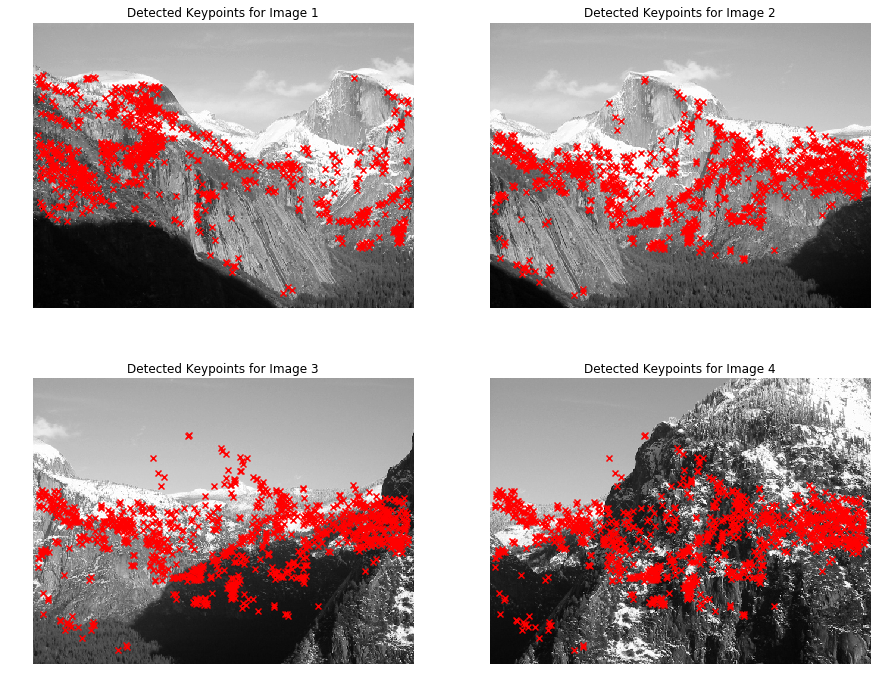

In [38]:
# Detect keypoints in 4 images
keypoints1 = corner_peaks(cv2.cornerHarris(img1, blockSize=2, ksize=3, k=0.04), 
                          threshold_rel=0.05, exclude_border=8)
keypoints2 = corner_peaks(cv2.cornerHarris(img2, blockSize=2, ksize=3, k=0.04), 
                          threshold_rel=0.1, exclude_border=8)
keypoints3 = corner_peaks(cv2.cornerHarris(img2, blockSize=2, ksize=3, k=0.04), 
                          threshold_rel=0.1, exclude_border=8)
keypoints4 = corner_peaks(cv2.cornerHarris(img2, blockSize=2, ksize=3, k=0.04), 
                          threshold_rel=0.1, exclude_border=8)


# Display detected keypoints
plt.subplots(2, 2, figsize=(15,12))
plt.subplot(2,2,1)
plt.imshow(img1, cmap='gray')
plt.scatter(keypoints1[:,1], keypoints1[:,0], marker='x',c='red')
plt.axis('off')
plt.title('Detected Keypoints for Image 1')

plt.subplot(2,2,2)
plt.imshow(img2, cmap='gray')
plt.scatter(keypoints2[:,1], keypoints2[:,0], marker='x',c='red')
plt.axis('off')
plt.title('Detected Keypoints for Image 2')

plt.subplot(2,2,3)
plt.imshow(img3, cmap='gray')
plt.scatter(keypoints3[:,1], keypoints3[:,0], marker='x',c='red')
plt.axis('off')
plt.title('Detected Keypoints for Image 3')

plt.subplot(2,2,4)
plt.imshow(img4, cmap='gray')
plt.scatter(keypoints4[:,1], keypoints4[:,0], marker='x',c='red')
plt.axis('off')
plt.title('Detected Keypoints for Image 4')

plt.show()

In [39]:
from utils import plot_matches
def visualizeMatching(img1,img2,keypoints1,keypoints2,threshold=0.5):
    patch_size = 5
    # Extract features from the corners
    desc1 = describe_keypoints(img1, keypoints1,
                               desc_func=simple_descriptor,
                               patch_size=patch_size)
    desc2 = describe_keypoints(img2, keypoints2,
                               desc_func=simple_descriptor,
                               patch_size=patch_size)

    # Match descriptors in image1 to those in image2
    matches = match_descriptors(desc1, desc2, threshold)

    # Plot matches
    fig, ax = plt.subplots(1, 1, figsize=(15, 12))
    ax.axis('off')
    plot_matches(ax, img1, img2, keypoints1, keypoints2, matches)
    plt.show()
    

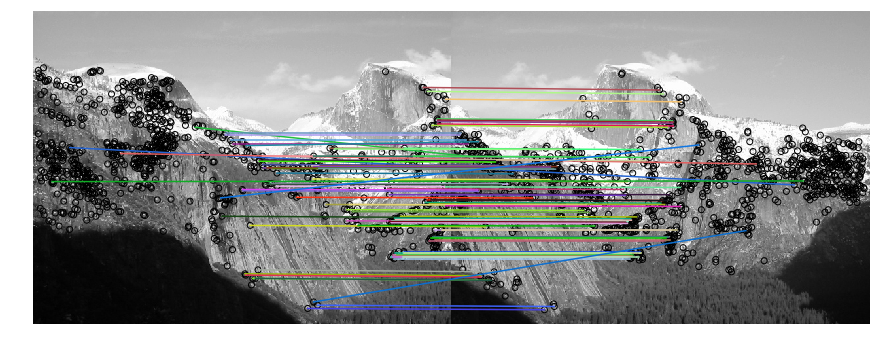

In [40]:
visualizeMatching(img1,img2,keypoints1,keypoints2,0.7)

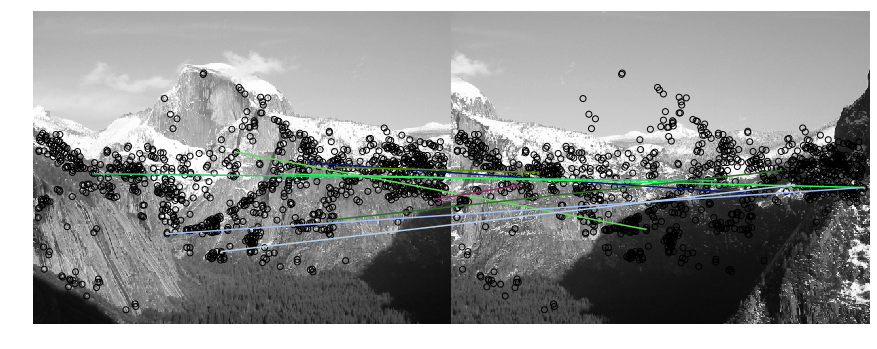

In [41]:
visualizeMatching(img2,img3,keypoints2,keypoints3,0.7)

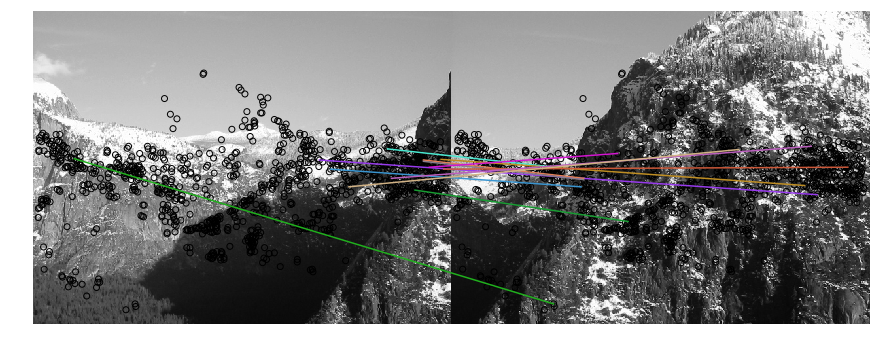

In [42]:
visualizeMatching(img3,img4,keypoints3,keypoints4,0.7)

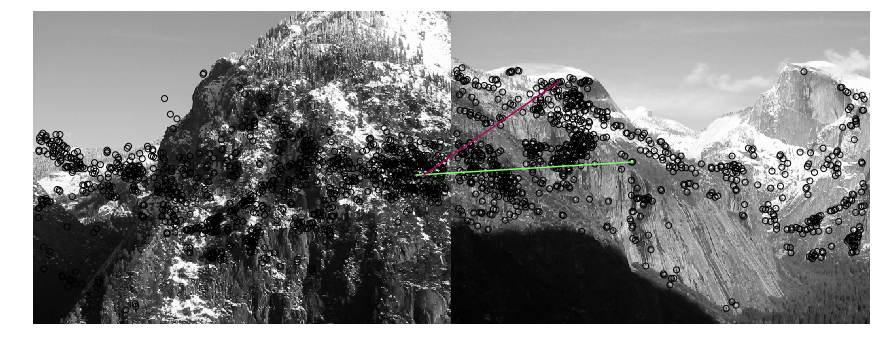

In [43]:
visualizeMatching(img4,img1,keypoints4,keypoints1,0.7)